In [6]:
# importing libraries
import numpy as np
import matplotlib.pyplot as plt
import logging
from tqdm.auto import trange, tqdm
from matplotlib import cm
#from matplotlib.colors import Normalize, ListedColormap, LinearSegmentedColormap
#from matplotlib.cm import ScalarMappable

from scipy.optimize import curve_fit
import json

# import custom class
from RandomLoop import stateSpace, create_cmap

MEDIA_PATH = r'C:\Users\lollo\Documents\Università\Thesis\Media/'

#plt.style.use("default")
plt.style.use("dark_background")
#plt.style.use("seaborn-v0_8-pastel")
#plt.style.use("fast")

In [2]:
# logging settings
logger = logging.getLogger()

#logger.setLevel(logging.CRITICAL + 1) # To turn off
logger.setLevel(logging.INFO)  

In [2]:
%%html
<style>
.cell-output-ipywidget-background {
    background-color: transparent !important;
}
:root {
    --jp-widgets-color: var(--vscode-editor-foreground);
    --jp-widgets-font-size: var(--vscode-editor-font-size);
}  
</style>

In [11]:
# initialize the grid
m = stateSpace(num_colors = 3, grid_size = 64, beta = 0.1 , init = 0, bc = 0, algo='metropolis')  

# run it
m.step(100_000) # about 3 seconds for 100k steps on my PC

# plot it
#m.plot_overlap(alpha = 0.9, normalized = True, file_name = MEDIA_PATH + 'overlap_cool.pdf', linewidth = 1) #, file_name = '64_0_9_U2.pdf')
#m.plot_overlap(normalized=True)
#m.plot_grid()

m.summary()

  0%|          | 0/100000 [00:00<?, ?it/s]

average number of links: [1.08172635 1.0828742  1.09090909]
max number of links: [ 9  9 10]
avg local time: 6.7275390625
avg loop length: 31.689385474860334
max loop length: 7760
steps = 100000   acceptance ratio = 0.381850


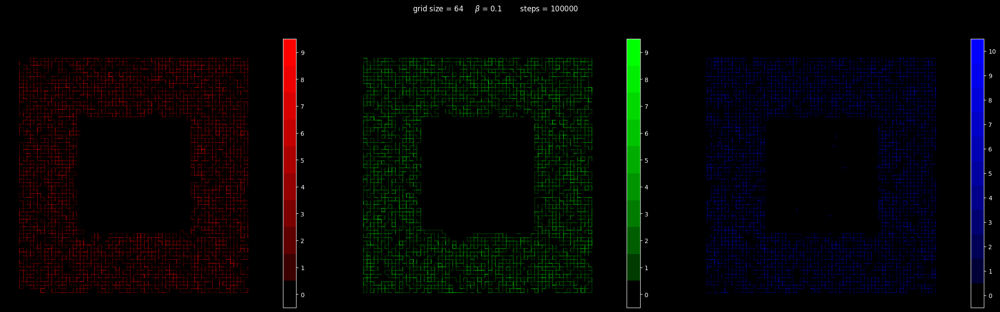

In [12]:
%matplotlib inline
m.plot_grid()

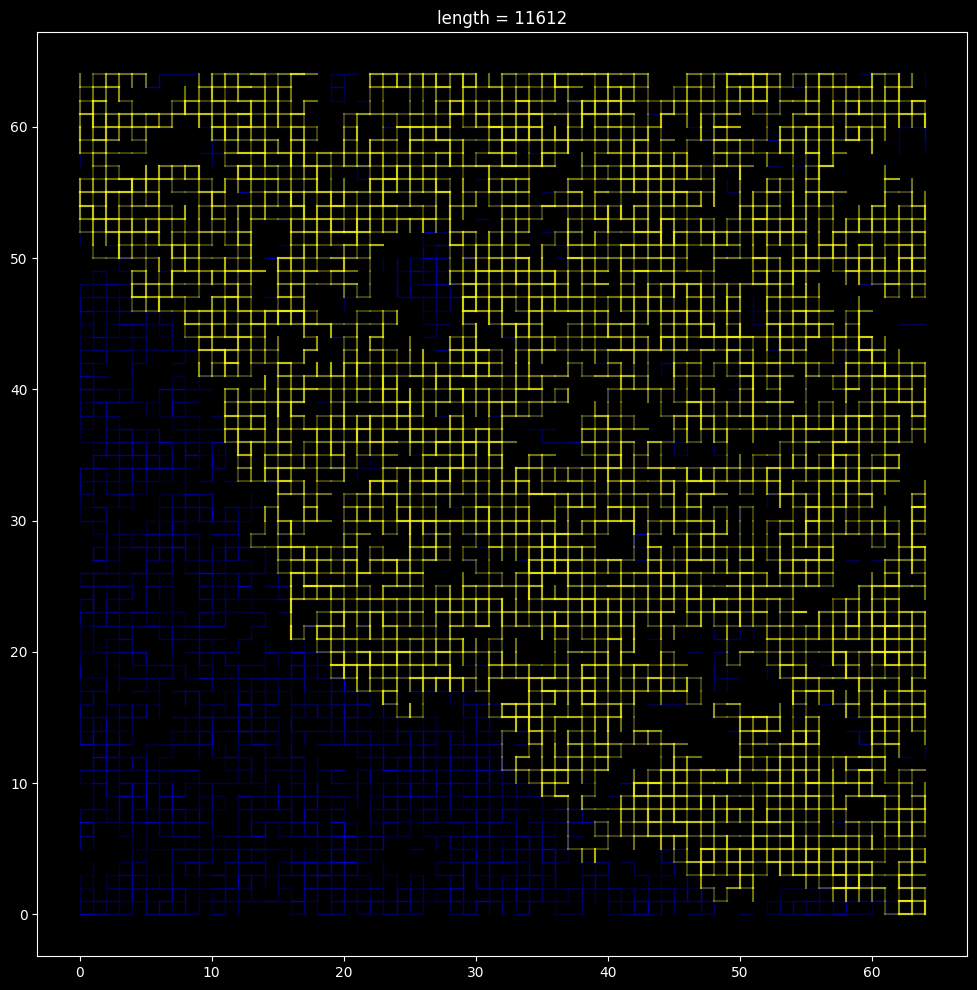

In [16]:
max_l = 0
longest = []
col = 0
for c in range(m.num_colors):
    for loop in l[c]:
        if len(loop) >= max_l:
            longest = loop
            col = c
            max_l = len(loop)
m.plot_loop(col, longest, )

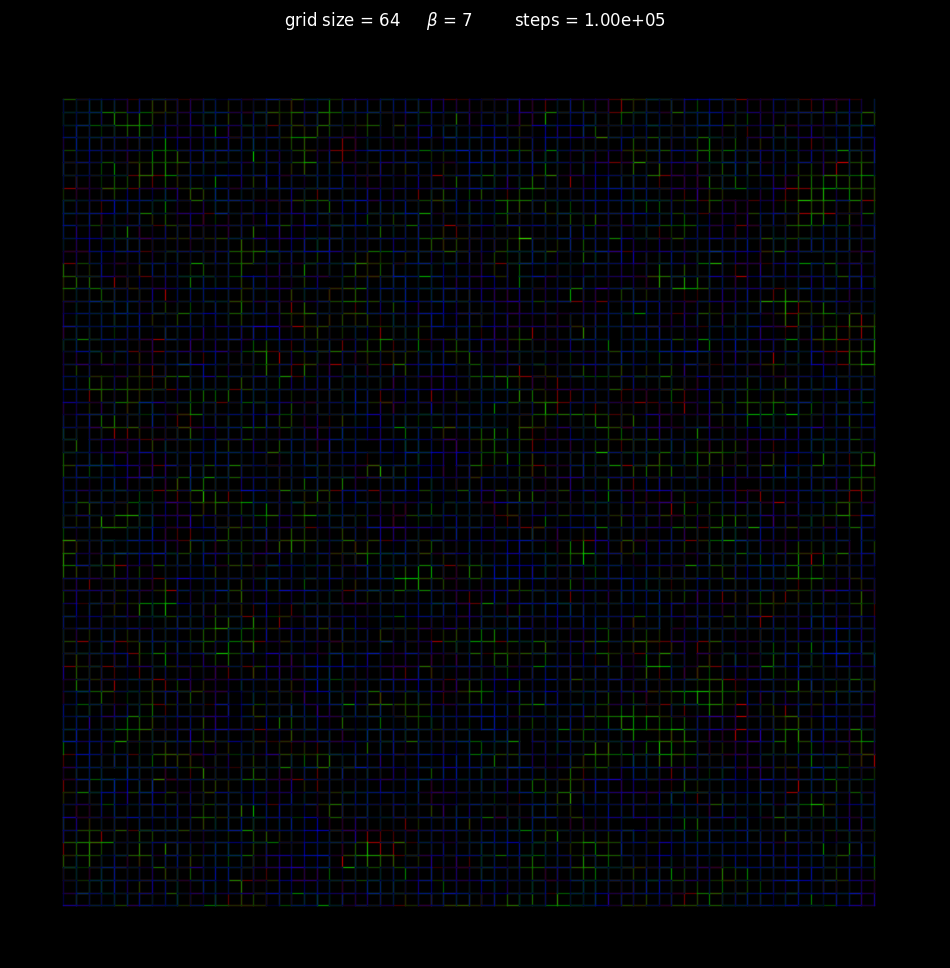

In [17]:
m.plot_overlap(normalized = False, linewidth= 1)

# Avg Links of different colors are anticorrelated



correlation coefficient = -0.807


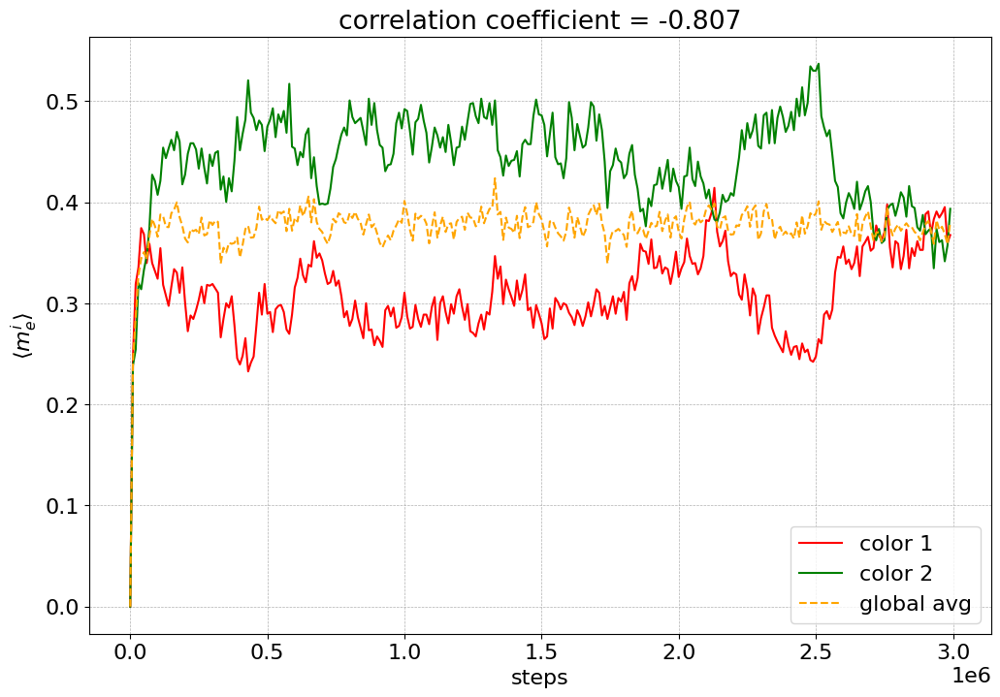

In [142]:
# 2 colors avg links correlation

plt.figure(figsize=(12,8))

x = np.arange(0,3_000_000, 10_000)
avg = np.mean(m.data['avg_links'], axis = 1)

# remove first 10 datapoints
y_1 = np.array(m.data['avg_links']).T[0][10:]
y_2 = np.array(m.data['avg_links']).T[1][10:]


# correlation coeff.
corr = np.corrcoef(y_1, y_2)

plt.rcParams["axes.prop_cycle"] = plt.cycler('color', ['red', 'green', 'blue'])
plt.rcParams.update({'font.size': 16})

plt.plot(x, m.data['avg_links'], label = ['color 1','color 2'])
plt.plot(x, avg, linestyle = '--', label = 'global avg', color = 'orange')
plt.title('correlation coefficient = {:.3f}'.format(corr[0,1]))

plt.xlabel('steps')
plt.ylabel(r'$\langle m_e^i \rangle$')
plt.grid(linewidth=0.5, linestyle = '--')
plt.xticks(np.arange(0, 3_500_000, 500_000))
plt.ticklabel_format(axis = 'x', style = 'sci', scilimits=(0,0))

plt.legend()
# quick correlation check

plt.savefig(MEDIA_PATH + '2_cols_avg_links.pdf')


print('correlation coefficient = {:.3f}'.format(corr[0,1]))


correlation coefficient = -0.807


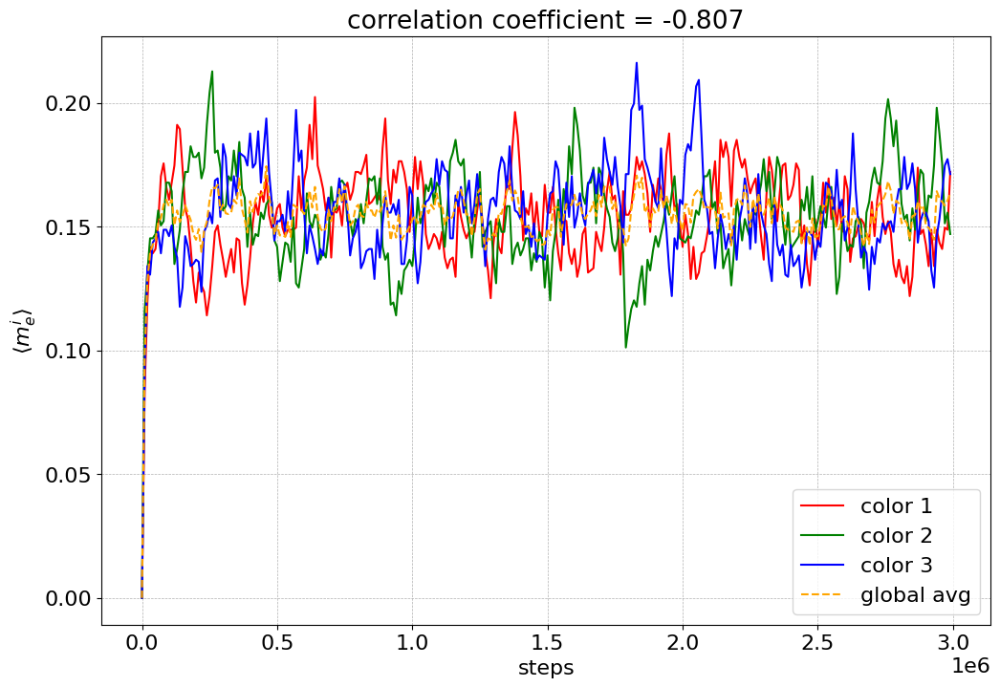

In [145]:
# 3 colors avg links correlation

plt.figure(figsize=(12,8))

x = np.arange(0,3_000_000, 10_000)
avg = np.mean(m.data['avg_links'], axis = 1)

# remove first 10 datapoints
y_1 = np.array(m.data['avg_links']).T[0][10:]
y_2 = np.array(m.data['avg_links']).T[1][10:]
y_3 = np.array(m.data['avg_links']).T[2][10:]

# correlation coeff.
corr_1 = np.corrcoef(y_1, y_2)
corr_2 = np.corrcoef(y_1, y_3)
corr_3 = np.corrcoef(y_2, y_3)

plt.rcParams["axes.prop_cycle"] = plt.cycler('color', ['red', 'green', 'blue'])
plt.rcParams.update({'font.size': 16})

plt.plot(x, m.data['avg_links'], label = ['color 1','color 2', 'color 3'])
plt.plot(x, avg, linestyle = '--', label = 'global avg', color = 'orange')
plt.title('correlation coefficient = {:.3f}'.format(corr[0,1]))

plt.xlabel('steps')
plt.ylabel(r'$\langle m_e^i \rangle$')
plt.grid(linewidth=0.5, linestyle = '--')
plt.xticks(np.arange(0, 3_500_000, 500_000))
plt.ticklabel_format(axis = 'x', style = 'sci', scilimits=(0,0))

plt.legend()
# quick correlation check

plt.savefig(MEDIA_PATH + '2_cols_avg_links.pdf')


print('correlation coefficient = {:.3f}'.format(corr[0,1]))

# SOOOO UGLY!

 With 2 colors the avg num of links is clearly anti-correlated!

# Equilibrium check

We sample every $10k$ steps the average number of links, average local time and average loop length. We plot these values normalized as a functions of time to check if the chain has reached equilibrium.

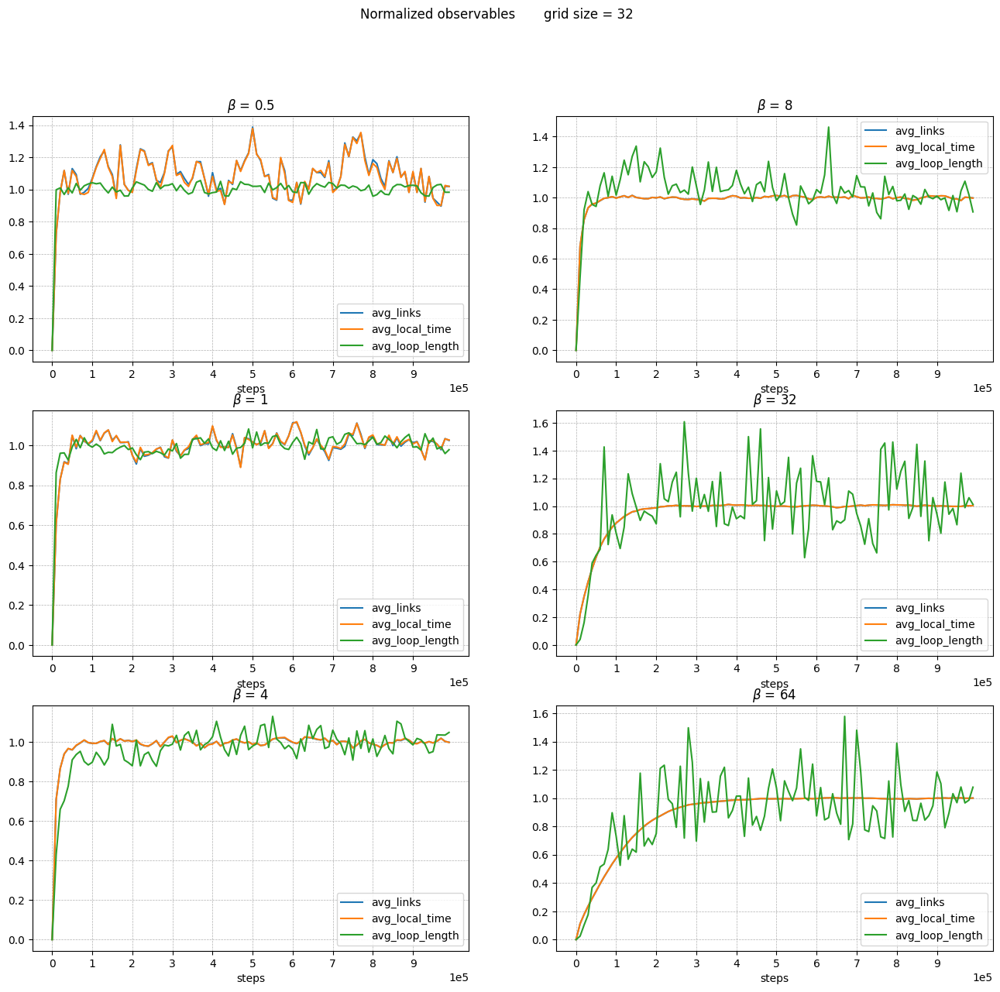

CPU times: total: 5min 26s
Wall time: 5min 34s


In [103]:
%%time

STEPS = 1_000_000
SAMPLE_RATE = 10_000

# define an array of betas
betas = [0.5, 1, 4, 8, 32, 64]

# plot relevant observables normalized to last value
fig, axes = plt.subplots(3, 2, figsize = (16,14))

for i in range(3):
    for j in range(2):
        # initialize the grid and run the simulation
        m = stateSpace(num_colors = 3, grid_size = 32, beta = betas[i+3*j], init = 0, bc = 0, algo = 'metropolis')  
        observables = [m.avg_links, m.avg_local_time, m.avg_loop_length]
        m.step(num_steps = STEPS, progress_bar = False, sample_rate = SAMPLE_RATE, observables = observables)  
        
        x = np.arange(0, STEPS, SAMPLE_RATE)  
        
        # normalize with avg of last 10 values 
        for ob in observables:
            avg = np.mean(m.data[ob.__name__][-10:-1])
            axes[i,j].plot(x, np.array(m.data[ob.__name__]) / avg , label = ob.__name__)
            
        axes[i,j].legend()
        axes[i,j].set_xlabel('steps')
        axes[i,j].set_title(r'$\beta$ = {}'.format(m.beta))

        axes[i,j].grid(linewidth=0.5, linestyle = '--')
        axes[i,j].set_xticks(np.arange(0, STEPS, STEPS // 10))
        axes[i,j].ticklabel_format(axis = 'x', style = 'sci', scilimits=(0,0))
        
fig.suptitle(r'Normalized observables       grid size = {}'.format(m.grid_size))
plt.savefig(MEDIA_PATH'equilibrium_check.pdf')
plt.show()


# TODO Study mixing time 

We expect $T_{mix} \propto n^2 \beta^k$ 

We say the chain has reached equilibrium when the avg of the last 10 samples of...


In [21]:
betas = np.linspace(1, 100, 10)

STEPS = 1_000_000
SAMPLE_RATE = 100 
N = 10
steps_for_eq = []


def check_equilibrium(data, eps = 1e-3):
    v1 = np.mean(data[-100:-50])
    v2 = np.mean(data[-50:])
    
    if abs((v2-v1)/v2) <= eps:
        return True 
    return False 

for beta in tqdm(betas):
    curr = []
    for _ in range(N):
        # init grid
        m = stateSpace(num_colors = 3, grid_size = 32, beta = beta, init = 0, bc = 0, algo = 'metropolis')  
        eq = False
        steps = 0
        while not eq:
            # sample 10 times
            m.step(num_steps = SAMPLE_RATE * 100, progress_bar = False, sample_rate = SAMPLE_RATE, observables = [m.avg_links])  
            
            steps += m.data['steps']
            # check for eq.
            eq = check_equilibrium(m.data['avg_links'])
        curr.append(steps)
    steps_for_eq.append(np.mean(curr))
        
    

  0%|          | 0/10 [00:00<?, ?it/s]

In [ ]:
plt.scatter(betas, steps_for_eq)

### Long sim

We now focus on small and big values of $\beta$, namely 2 and 64, but with $10M$ steps. 

In [ ]:
# low beta

# initialize the grid
m = stateSpace(num_colors = 3, grid_size = 64, beta = 2 , init = 0, bc = 0, algo='metropolis')  

# run it
m.step(10_000_000, sample_rate = 100_000)  # about 3 seconds for 100k steps on my PC

# plot relevant observables normalized to last value
fig, ax = plt.subplots(figsize = (16,8))

# steps
x = np.arange(0, 10_000_000, 100_000)  # we sampled every 10k steps

# normalize with avg of last 10 values 
n1 = np.mean(m.data1[-10:-1])
n2 = np.mean(m.data2[-10:-1])
n3 = np.mean(m.data3[-10:-1])


ax.plot(x, np.array(m.data1) / n1 , label = 'avg links')
ax.plot(x, np.array(m.data2) / n2, label = 'avg local time')
ax.plot(x, np.array(m.data3) / n3, label = 'avg loop length')
ax.legend()
ax.set_xlabel('steps')
ax.set_title(r'normalized observables              grid size = {}   $\beta$ = {}'.format(m.grid_size, m.beta))

ax.grid(linewidth=0.5, linestyle = '--')
ax.set_xticks(np.arange(0,10_100_000, 1_000_000))
ax.ticklabel_format(axis = 'x', style = 'sci', scilimits=(0,0))

plt.show()

  0%|          | 0/10000000 [00:00<?, ?it/s]

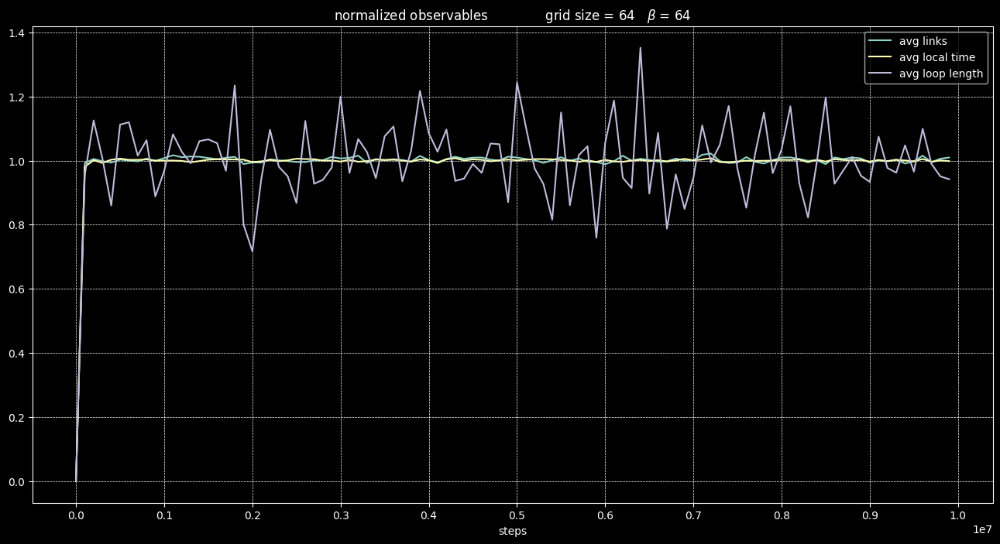

In [42]:
# high beta

# initialize the grid
m = stateSpace(num_colors = 3, grid_size = 64, beta = 64 , init = 0, bc = 0, algo = 'metropolis')  

# run it
m.step(10_000_000, sample_rate = 100_000)  # about 3 seconds for 100k steps on my PC

# plot relevant observables normalized to last value
fig, ax = plt.subplots(figsize = (16,8))

# steps
x = np.arange(0, 10_000_000, 100_000)  # we sampled every 10k steps

# normalize with avg of last 10 values 
n1 = np.mean(m.data1[-10:-1])
n2 = np.mean(m.data2[-10:-1])
n3 = np.mean(m.data3[-10:-1])


ax.plot(x, np.array(m.data1) / n1 , label = 'avg links')
ax.plot(x, np.array(m.data2) / n2, label = 'avg local time')
ax.plot(x, np.array(m.data3) / n3, label = 'avg loop length')
ax.legend()
ax.set_xlabel('steps')
ax.set_title(r'normalized observables              grid size = {}   $\beta$ = {}'.format(m.grid_size, m.beta))

ax.grid(linewidth=0.5, linestyle = '--')
ax.set_xticks(np.arange(0,10_100_000, 1_000_000))
ax.ticklabel_format(axis = 'x', style = 'sci', scilimits=(0,0))

plt.show()

# Hand-crafted starting configurations

We now consider two hand-crafted initial conditions: one in which there is a loop that visits all edges, which we call **snake**, and one with uniform links but with an hole in the middle, which we call **donut**. 

In [ ]:
STEPS = 1_000_000
SAMPLE_RATE = 10_000

m = stateSpace(num_colors = 3, grid_size = 32, beta = 8 , init = 0, bc = 0, algo = 'metropolis')

# donut state as initial state
build_donut(m)

'''
        # initialize the grid and run the simulation
        m = stateSpace(num_colors = 3, grid_size = 32, beta = betas[i+3*j], init = 0, bc = 0, algo = 'metropolis')  
        observables = [m.avg_links, m.avg_local_time, m.avg_loop_length]
        m.step(num_steps = STEPS, progress_bar = False, sample_rate = SAMPLE_RATE, observables = observables)  
        
        x = np.arange(0, STEPS, SAMPLE_RATE)  
        
        # normalize with avg of last 10 values 
        for ob in observables:
            avg = np.mean(m.data[ob.__name__][-10:-1])
            axes[i,j].plot(x, np.array(m.data[ob.__name__]) / avg , label = ob.__name__)
            
        axes[i,j].legend()
        axes[i,j].set_xlabel('steps')
        axes[i,j].set_title(r'$\beta$ = {}'.format(m.beta))

        axes[i,j].grid(linewidth=0.5, linestyle = '--')
        axes[i,j].set_xticks(np.arange(0, STEPS, STEPS // 10))
        axes[i,j].ticklabel_format(axis = 'x', style = 'sci', scilimits=(0,0))
'''
        
# observables to save
observables = [m.avg_links, m.avg_loop_length]
        
# run it
m.step(STEPS, sample_rate = SAMPLE_RATE, observables = observables)  # about 3 seconds for 100k steps on my PC

# plot relevant observables normalized to last value
fig, ax = plt.subplots(figsize = (16,8))


x = np.arange(0, STEPS, SAMPLE_RATE)  # we sampled every 10k steps

# normalize with avg of last 10 values 
for ob in observables:
    avg = np.mean(m.data[ob.__name__][-10:-1])
    ax.plot(x, np.array(m.data[ob.__name__]) / avg , label = ob.__name__)


ax.legend()
ax.set_xlabel('steps')
ax.set_title(r'normalized observables              grid size = {}   $\beta$ = {}'.format(m.grid_size, m.beta))

ax.grid(linewidth=0.5, linestyle = '--')
ax.set_xticks(np.arange(0,STEPS, 10*SAMPLE_RATE))
ax.ticklabel_format(axis = 'x', style = 'sci', scilimits=(0,0))

plt.show()

  0%|          | 0/10000000 [00:00<?, ?it/s]

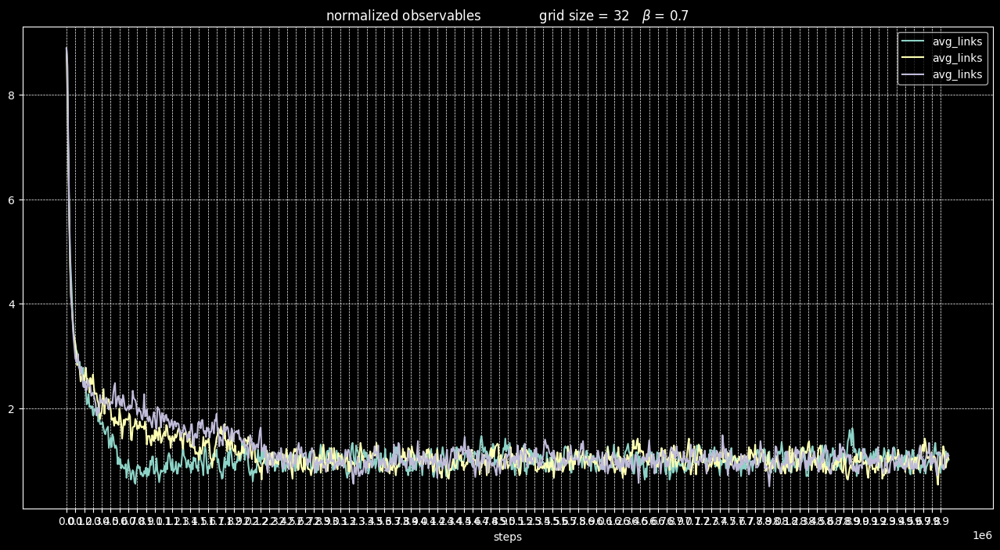

In [3]:
STEPS = 10_000_000
SAMPLE_RATE = 10_000

m = stateSpace(num_colors = 3, grid_size = 32, beta = 0.7 , init = 0, bc = 0, algo = 'metropolis')

# building the snake state

build_snake(m)


# observables to save
observables = [m.avg_links]
        
# run it
m.step(STEPS, sample_rate = SAMPLE_RATE, observables = observables)  # about 3 seconds for 100k steps on my PC

# plot relevant observables normalized to last value
fig, ax = plt.subplots(figsize = (16,8))


x = np.arange(0, STEPS, SAMPLE_RATE)  # we sampled every 10k steps

# normalize with avg of last 10 values 
for ob in observables:
    avg = np.mean(m.data[ob.__name__][-10:-1])
    ax.plot(x, np.array(m.data[ob.__name__]) / avg , label = ob.__name__)


ax.legend()
ax.set_xlabel('steps')
ax.set_title(r'normalized observables              grid size = {}   $\beta$ = {}'.format(m.grid_size, m.beta))

ax.grid(linewidth=0.5, linestyle = '--')
ax.set_xticks(np.arange(0,STEPS, 10*SAMPLE_RATE))
ax.ticklabel_format(axis = 'x', style = 'sci', scilimits=(0,0))

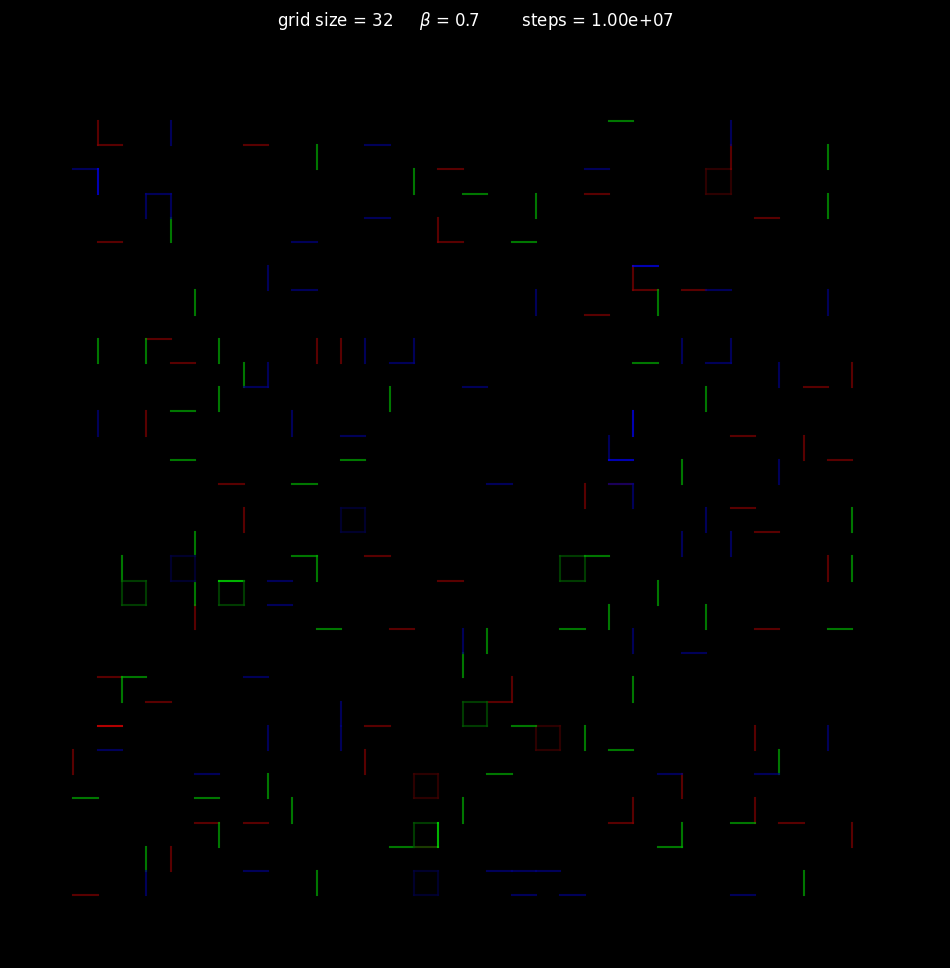

In [4]:
m.plot_overlap()

# Loops

number of loops: 116
mean length: 22.017241379310345


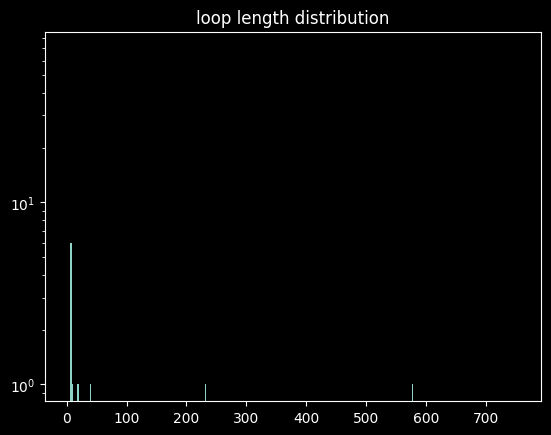

In [97]:
# choose a color
color = 0

loops, _ = m.loop_builder()

lengths = [len(l) for l in loops[color]]

plt.hist(lengths, log = True, align='left', bins = range(min(lengths), max(lengths) + 2, 1))
plt.title('loop length distribution')

print('number of loops: {}'.format(len(loops[color])))
print('mean length: {}'.format(np.mean(lengths)))


In [100]:
max(lengths)

754

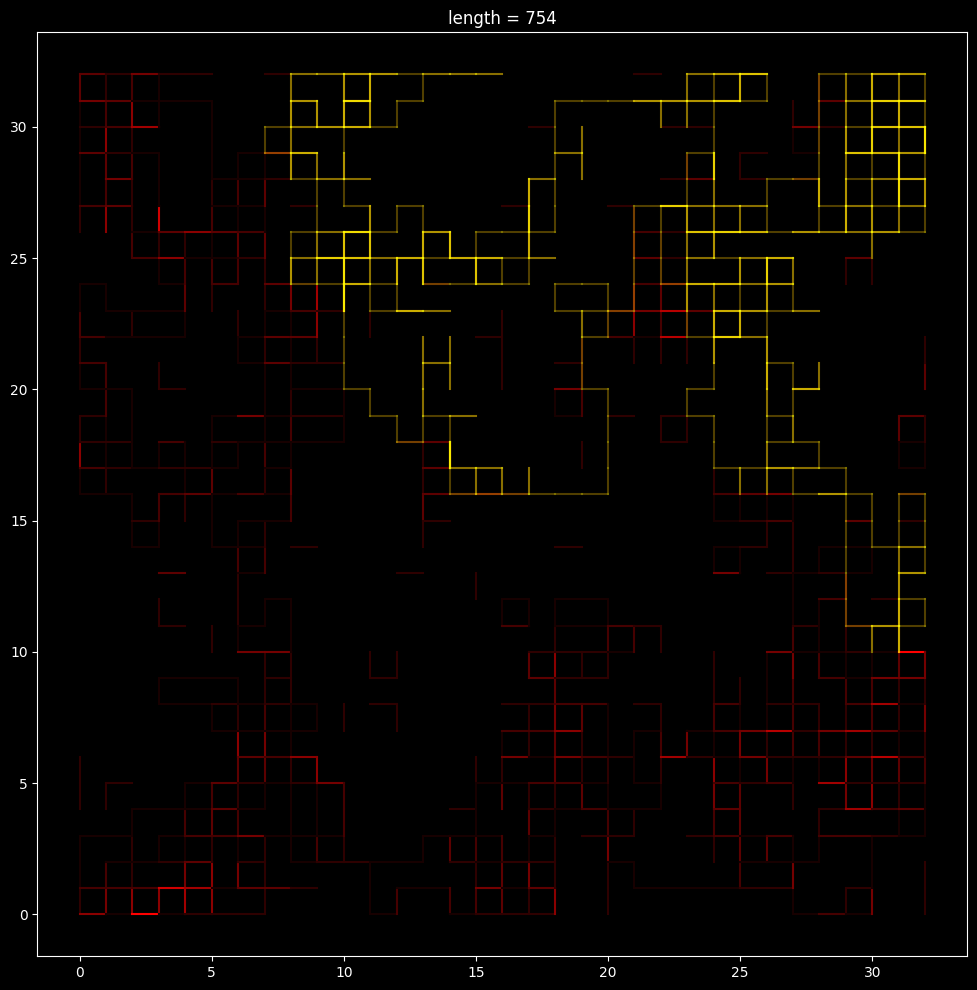

In [98]:
# find longest loop
max_length = max(lengths)

longest_loop =  []

for l in loops[color]:
    if len(l) == max_length:
        longest_loop = l

#plot it 
m.plot_loop(color, longest_loop)

# Avg links vs $\beta$

In [54]:

betas = np.linspace(0.5, 32, 8)

STEPS = 100_000
SAMPLE_RATE = 10_000

avg_links = []
avg_links_2 = []

for beta in tqdm(betas):
    # 3 colors
    m = stateSpace(num_colors = 3, grid_size = 32, beta = beta , init = 0, bc = 0, algo='metropolis')  #(num_colors = 3, grid_size = 10, beta = 1, uniform_init = False)  #0.1875
    # reach eq.
    m.step(500_000, progress_bar = False)
    # sample
    m.step(STEPS, sample_rate=SAMPLE_RATE, observables=[m.avg_links], progress_bar = False)
    
    avg_links.append( np.mean(m.data['avg_links']) )
    
    # 2 colors
    m = stateSpace(num_colors = 2, grid_size = 32, beta = beta , init = 0, bc = 0, algo='metropolis')  #(num_colors = 3, grid_size = 10, beta = 1, uniform_init = False)  #0.1875
    # reach eq.
    m.step(500_000, progress_bar = False)
    # sample
    m.step(STEPS, sample_rate=SAMPLE_RATE, observables=[m.avg_links], progress_bar = False)
    
    avg_links_2.append( np.mean(m.data['avg_links']) )
        


  0%|          | 0/8 [00:00<?, ?it/s]

N = 3    a = 0.333 +/- 0.000     b = -0.149 +/- 0.000
N = 2    a = 0.500 +/- 0.000     b = -0.124 +/- 0.001


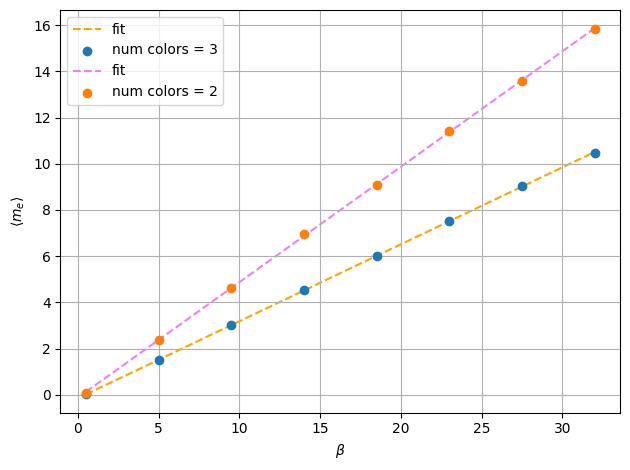

In [56]:
def linear(x,a,b):
    return a*x + b

p, pcov = curve_fit(linear, betas, avg_links)

print('N = 3    a = {:.3f} +/- {:.3f}     b = {:.3f} +/- {:.3f}'.format(p[0], pcov[0][0], p[1], pcov[1][1]))
y = [linear(beta, p[0], p[1]) for beta in betas]

plt.plot(betas,y, label = 'fit', color = 'orange', linestyle = '--', zorder = 1)
plt.scatter(betas, avg_links, label = 'num colors = 3', zorder = 2)

p, pcov = curve_fit(linear, betas, avg_links_2)
print('N = 2    a = {:.3f} +/- {:.3f}     b = {:.3f} +/- {:.3f}'.format(p[0], pcov[0][0], p[1], pcov[1][1]))
y = [linear(beta, p[0], p[1]) for beta in betas]

plt.plot(betas,y, label = 'fit', color = 'violet', linestyle = '--', zorder = 1)
plt.scatter(betas, avg_links_2, label = 'num colors = 2', zorder = 2)

plt.xlabel(r'$\beta$')
plt.ylabel(r'$\langle m_e \rangle$')


# Adjust layout
plt.tight_layout()

plt.legend()
plt.grid()

plt.savefig(MEDIA_PATH + 'avg_links_vs_beta_2_3.pdf')
plt.show()

In [158]:
len(m.data['get_grid'][0][0])

34

# Animations

In [2]:
# initialize the grid
m = stateSpace(num_colors = 3, grid_size = 64, beta = 2 , init = 'snake', bc = 0, algo='metropolis')  

# run it
m.step(100_000, sample_rate=1000, observables= [m.get_grid])

  0%|          | 0/100000 [00:00<?, ?it/s]

In [ ]:
%matplotlib inline
from ipywidgets import interact, fixed, widgets, interact_manual


def plot_one_optimized(grid, c, cmap, ax, alpha=1.0):
    """
    Optimized function to plot grid lines using batch drawing with LineCollection for efficiency.
    """
    # Initialize lists to collect line segments
    segments = []

    # Collect line segments for horizontal and vertical lines
    for x in range(len(grid[0][0])):
        for y in range(len(grid[0][0])):
            # horizontal lines
            if grid[c][x][y][0] != 0:
                segments.append([(x - 1, y), (x, y)])
            # vertical lines
            if grid[c][x][y][1] != 0:
                segments.append([(x, y), (x, y - 1)])

    # Assuming colors are normalized between 0 and 1, adjust as needed
    line_colors = [cmap(grid[c][x][y][z]) for x in range(len(grid[0][0])) for y in range(len(grid[0][0])) for z in range(2) if grid[c][x][y][z] != 0]

    # Create a LineCollection
    lc = LineCollection(segments, colors=line_colors, linewidths=1.5, alpha=alpha)
    ax.add_collection(lc)


def plot_over(i, normalized = False):
    figsize = (12,12) 
    file_name = None
    grid_size = m.grid_size
    # Create a figure and axes
    fig, ax = plt.subplots(figsize = figsize)

    max_links = np.max(m.data['get_grid'], axis = (0, 2, 3, 4))
    
    for c in range(3):
        # Define a colormap
        num_segments = int(max_links[c] + 1) if not normalized else 2
        cmap = create_cmap(c, num_segments)
        
        # Create a ScalarMappable for colorbar
        norm = Normalize(vmin=0, vmax=num_segments)
        sm = ScalarMappable(cmap=cmap, norm=norm)
        sm.set_array([])  # Empty array, as we'll not use actual data

        plot_one_optimized(m.data['get_grid'][i], c, cmap, ax, 0.6)
        #ax.set_title(r'grid size = {}     $\beta$ = {}        steps = {:g}'.format(self.grid_size, self.beta, self.accepted + self.rejected))
        ax.set_xlim(-(1+0.05*grid_size), 2+grid_size*1.05)
        ax.set_ylim(-(1+0.05*grid_size), 2+grid_size*1.05)
        #ax.axis('square')
        ax.set_title('step {}'.format(i*m.sample_rate) )
        ax.axis('off')

    #save it
    if file_name != None:
        plt.savefig(file_name)
    plt.show()


play = widgets.Play(
#     interval=10,
    value = 0,
    min = 0,
    max = len(m.data['get_grid'])-1,
    step = 1,
    description="Press play",
    disabled=False
)

slider = widgets.IntSlider()

# Create an interactive slider from 0 to 99
interact(plot_over, i = slider)

widgets.jslink((play, 'value'), (slider, 'value'))
widgets.HBox([play, slider])

In [4]:
from matplotlib.collections import LineCollection


def plot_one_optimized(grid, c, cmap, ax, alpha=1.0):
    """
    Optimized function to plot grid lines using batch drawing with LineCollection for efficiency.
    """
    # Initialize lists to collect line segments
    segments = []

    # Collect line segments for horizontal and vertical lines
    for x in range(len(grid[0][0])):
        for y in range(len(grid[0][0])):
            # horizontal lines
            if grid[c][x][y][0] != 0:
                segments.append([(x - 1, y), (x, y)])
            # vertical lines
            if grid[c][x][y][1] != 0:
                segments.append([(x, y), (x, y - 1)])

    # Assuming colors are normalized between 0 and 1, adjust as needed
    line_colors = [cmap(grid[c][x][y][z]) for x in range(len(grid[0][0])) for y in range(len(grid[0][0])) for z in range(2) if grid[c][x][y][z] != 0]

    # Create a LineCollection
    lc = LineCollection(segments, colors=line_colors, linewidths=1.5, alpha=alpha)
    ax.add_collection(lc)

# Placeholder for the animation's frame update function
def get_frame(i, ax, normalized=True):
   
    grid_size = m.grid_size  
    num_segments = 2  # Example, replace with actual logic to determine number of segments

    ax.clear()
    
    for c in range(m.num_colors):
        # Placeholder for cmap creation logic
        cmap = create_cmap(m.num_colors, c, num_segments)  # Example colormap, replace with actual logic
        plot_one_optimized(m.data['get_grid'][i], c, cmap, ax, 0.6)
    ax.set_xlim(-(1 + 0.05 * grid_size), 2 + grid_size * 1.05)
    ax.set_ylim(-(1 + 0.05 * grid_size), 2 + grid_size * 1.05)
    ax.axis('off')

# This function assumes the existence of a global 'm' object with data for plotting
# It should be adjusted according to the actual data structure and plotting requirements


### Messing with widgets to get a simple interface

In [5]:
%matplotlib notebook

plt.style.use("dark_background")

from matplotlib.animation import FuncAnimation
from IPython.display import display, HTML

fig, ax = plt.subplots(figsize=(12, 12))

# adjust the range and interval based on your data and desired animation speed
animation = FuncAnimation(fig, get_frame, frames=len(m.data['get_grid']), interval=50, repeat=False, blit = True, fargs = [ax, False])

# Display the animation in the notebook
HTML(animation.to_jshtml())


<IPython.core.display.Javascript object>

In [8]:
m.data['get_grid'][-1]

array([[[[0, 0],
         [0, 0],
         [0, 1],
         ...,
         [0, 2],
         [0, 1],
         [0, 0]],

        [[2, 0],
         [1, 1],
         [2, 1],
         ...,
         [3, 0],
         [3, 2],
         [0, 0]],

        [[3, 0],
         [1, 1],
         [1, 0],
         ...,
         [3, 2],
         [3, 0],
         [0, 0]],

        ...,

        [[2, 0],
         [3, 2],
         [3, 1],
         ...,
         [1, 1],
         [0, 0],
         [0, 0]],

        [[0, 0],
         [0, 0],
         [0, 0],
         ...,
         [2, 0],
         [2, 0],
         [0, 0]],

        [[0, 0],
         [0, 0],
         [0, 0],
         ...,
         [0, 0],
         [0, 0],
         [0, 0]]],


       [[[0, 0],
         [0, 1],
         [0, 1],
         ...,
         [0, 1],
         [0, 1],
         [0, 0]],

        [[1, 0],
         [0, 2],
         [0, 4],
         ...,
         [2, 3],
         [1, 1],
         [0, 0]],

        [[1, 0],
         [2, 1],
      

In [11]:
animation.save('snake_1M_2.mp4')

# Correlations

In [7]:
def compute_corr():
    x0, y0 = m.grid_size // 2, m.grid_size // 2
    vertices = [ (x0+dx,y0) for dx in range(0, m.grid_size // 2, 2)]
    
    is_connected = []
    
    for v in vertices:
        is_connected.append(m.loop_builder((x0,y0), v))

    return is_connected

In [19]:
betas = np.linspace(1, 32, 6)
corrs = []

for beta in tqdm(betas):
    m = stateSpace(num_colors=3, grid_size= 64, beta=2)

    # reach equilibrium
    m.step(num_steps=500_000, progress_bar = False)

    # sample 
    m.step(num_steps=10_000_000, sample_rate=100_000, observables=[compute_corr], progress_bar = False)
    
    # save 
    corrs.append(np.mean(m.data['compute_corr'], axis= (0)))
    
    

  0%|          | 0/6 [00:00<?, ?it/s]

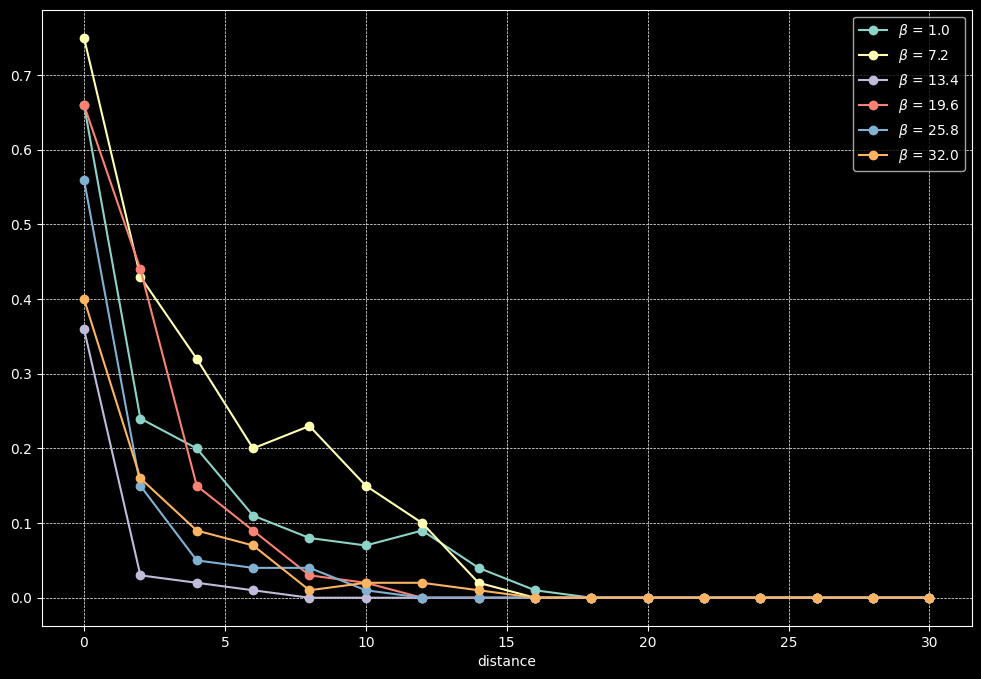

In [37]:
# plot relevant observables normalized to last value
fig, ax = plt.subplots(figsize = (12,8))

for i in range(6):

        x = np.arange(0, m.grid_size // 2, 2)

        ax.plot(x, corrs[i], label=r'$\beta$ = {}'.format(betas[i]), marker='o')
            
        ax.legend()
        ax.set_xlabel('distance')
       
        ax.grid(linewidth=0.5, linestyle = '--')
        #ax.set_xticks(np.arange(0, STEPS, STEPS // 10))
        
#fig.suptitle(r'Normalized observables       grid size = {}'.format(m.grid_size))
plt.savefig(MEDIA_PATH + 'corr.pdf')
plt.show()

In [44]:
file_name = 'corrs_1.npy'

with open(file_name, 'wb') as file:
    np.save(file, corrs)

In [2]:
def my_exp(x, a, b, c):
    return a * np.exp( b*x ) + c

# dump first values, convergence not reached 
y = np.mean(m.data['compute_corr'], axis= (0))
x = np.arange(0, m.grid_size // 2, 4)
#plt.plot(list(range(0, m.grid_size // 2, 2)), y, 'o')


# fit best exp
p, pcov = curve_fit(my_exp, x, y, p0 = (0.4, -1, 0))

print('N = 3    a = {:.3f} +/- {:.3f}     b = {:.3f} +/- {:.3f}     c = {:.3f} +/- {:.3f}'.format(p[0], pcov[0][0], p[1], pcov[1][1], p[2], pcov[2][2]))

x_fit = np.linspace(0, 30, 100)
y_fit = [my_exp(k, p[0], p[1], p[2]) for k in x_fit]

plt.plot(x_fit, y_fit, label = 'fit', color = 'orange', linestyle = '--', zorder = 1)
plt.scatter(x, y, label = 'num colors = 3', zorder = 2)


NameError: name 'np' is not defined

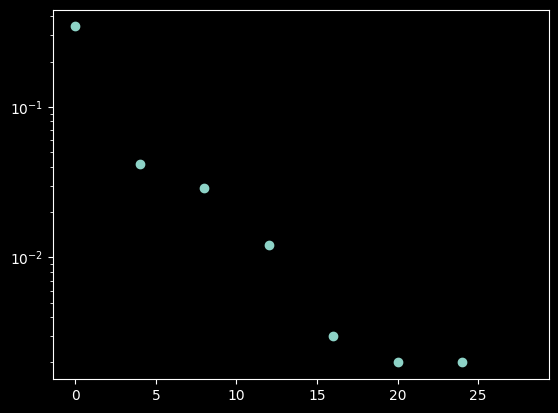

In [58]:
plt.plot(x, y, 'o')
plt.yscale('log')

# Figures for the thesis

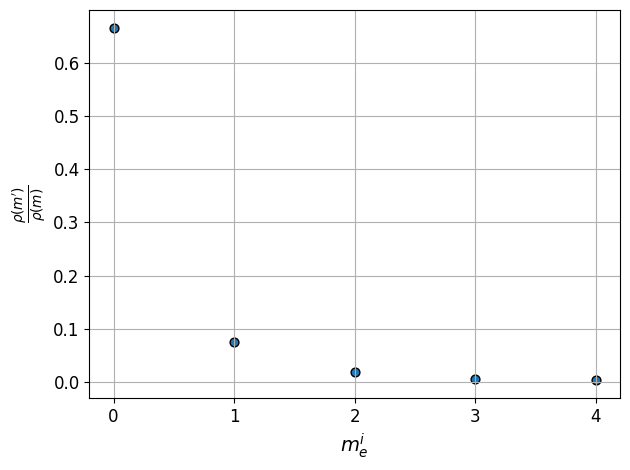

In [51]:
# prob ratios goes to zero with $U^{+1}$ and enought links on the edges


def acc_prob(beta, m):
    return beta**4 * (2*m+1) / ( (m+1)**4 * (3/2 + m))

x = np.arange(0, 5, 1)


y = [acc_prob(1, m) for m in x]
lab = r'$\beta$ = ' + str(b)
plt.scatter(x, y, marker='o', edgecolor='black', s=40)  # Customizing marker style, color, and size


plt.xlabel(r'$m_e^i$', fontsize=14)  # Customizing x-axis label and font size
plt.ylabel(r"$\frac{\rho(m')}{\rho(m)}$", fontsize=14)  # Customizing y-axis label and font size
#plt.title('', fontsize=16)   # Adding title and customizing font size
plt.grid(True)                           # Adding grid
plt.xticks(np.arange(min(x), max(x)+1, 1), fontsize=12)                  # Customizing x-axis tick font size
plt.yticks(fontsize=12)                  # Customizing y-axis tick font size
plt.tight_layout()                       # Adjust layout to prevent clipping of labels
plt.savefig(r'C:\Users\lollo\Documents\Università\Thesis\Media/acc_prob.pdf')

In [18]:
def generate_tikz_code(matrix):
    rows = len(matrix)
    cols = len(matrix[0])

    tikz_code = "\\begin{tikzpicture}[scale=2]\n"
    
    # Grid lines with edge labels
    for i in range(3):
        for j in range(3):
                tikz_code += f"\\draw ({j},{i}) -- ({j+1},{i}) node[midway,below, font = \\footnotesize] {{{horiz[3*i+j]}}};\n"  # Horizontal edges
                tikz_code += f"\\draw ({j},{i}) -- ({j},{i+1}) node[midway,left, font = \\footnotesize] {{{vert[3*j+i]}}};\n"   # Vertical edges
    
    # Adding top and left edges
    for i in range(3):
        tikz_code += f"\\draw ({i},{3}) -- ({i+1},{3}) node[midway,below, font = \\footnotesize] {{{horiz[3*i+3]}}};\n"  # Horizontal edges
    
    for i in range(3):
        tikz_code += f"\\draw ({3},{i}) -- ({3},{i+1}) node[midway,left, font = \\footnotesize] {{{horiz[3*i+3]}}};\n"  # Horizontal edges

    # Circles at each intersection
    for i in range(cols):
        for j in range(rows):
            tikz_code += f"\\filldraw ({i},{j}) circle (1pt);\n"  # Reduced circle size to 0.5pt
    
    tikz_code += "\\end{tikzpicture}"
    
    return tikz_code

# Example usage
horiz = np.random.randint(0,4,12)
vert = np.random.randint(0,4,12)
tikz_code = generate_tikz_code(matrix)
print(tikz_code)


\begin{tikzpicture}[scale=2]
\draw (0,0) -- (1,0) node[midway,below, font = \footnotesize] {2};
\draw (0,0) -- (0,1) node[midway,left, font = \footnotesize] {0};
\draw (1,0) -- (2,0) node[midway,below, font = \footnotesize] {0};
\draw (1,0) -- (1,1) node[midway,left, font = \footnotesize] {2};
\draw (2,0) -- (3,0) node[midway,below, font = \footnotesize] {3};
\draw (2,0) -- (2,1) node[midway,left, font = \footnotesize] {2};
\draw (0,1) -- (1,1) node[midway,below, font = \footnotesize] {0};
\draw (0,1) -- (0,2) node[midway,left, font = \footnotesize] {1};
\draw (1,1) -- (2,1) node[midway,below, font = \footnotesize] {3};
\draw (1,1) -- (1,2) node[midway,left, font = \footnotesize] {1};
\draw (2,1) -- (3,1) node[midway,below, font = \footnotesize] {3};
\draw (2,1) -- (2,2) node[midway,left, font = \footnotesize] {2};
\draw (0,2) -- (1,2) node[midway,below, font = \footnotesize] {2};
\draw (0,2) -- (0,3) node[midway,left, font = \footnotesize] {3};
\draw (1,2) -- (2,2) node[midway,below, 